In [1]:
from load_modules import *

In [2]:
physical_devices = tf.config.list_physical_devices('GPU')
if len(physical_devices) > 0:
    for device in physical_devices:
        print("Device:", device)
else:
    print("No GPU devices found.")
tf.compat.v1.disable_eager_execution()
tf.compat.v1.GPUOptions(per_process_gpu_memory_fraction=1.0)
tf.compat.v1.GPUOptions(allow_growth=True)
tf.config.list_physical_devices('GPU')
tf.test.gpu_device_name()
device_lib.list_local_devices()
name = tf.test.gpu_device_name()
if name != '/device:GPU:0':
    raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(name))
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
###
CMAP_SPECULAR = mpl.colormaps["viridis"]

Device: PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')
Found GPU at: /device:GPU:0
Num GPUs Available:  1


In [48]:
# with tf.device('/device:GPU:0'):
np.random.seed(42)
#load csv into 
# data_path = r"C:\Users\joeli\OneDrive\Documents\GitHub\EncoderDecoder\JJ_LUT.csv"
headers = "Cm,Ch,Bm,Bh,T,sR,sG,sB,L,A,B"

lut_path1 = r"C:\Users\joeli\OneDrive\Documents\GitHub\PhysicalModels\LargeMCLUT.csv"
lut_path2 = r"C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\data\mcnew.csv"
lut_path3 = r"C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\data\nobh_lut.csv"
lut_path4 = r"C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\data\JJ_LUT_fixedT.csv"
lut_path5 = r"C:\Users\joeli\OneDrive\Documents\GitHub\MC_LUT_Statistical\data\default_LUT.csv"
df1 = pd.read_csv(lut_path1)
df2 = pd.read_csv(lut_path2)
df2.drop(df2.index[0], inplace=True)
df3 = pd.read_csv(lut_path3)
df3.drop(df3.index[0], inplace=True)
df4 = pd.read_csv(lut_path4)
df4.drop(df4.index[0], inplace=True)
df5 = pd.read_csv(lut_path5)
df5.drop(df5.index[0], inplace=True)
#concatenate the two dataframes
df = pd.concat([df1, df2])
print(f"df shape {df.shape}")
df.drop(df.index[0], inplace=True)
# Filter out non-numeric rows
def is_numeric(string):
    try:
        float(string)
        return True
    except ValueError:
        return False

x = df[['sR', 'sG', 'sB']].applymap(is_numeric)
x = df[x.all(axis=1)][['sR', 'sG', 'sB']].to_numpy(dtype='float32')

y = df[['Cm', 'Ch', 'Bm', 'Bh', 'T']].applymap(is_numeric)
y = df[y.all(axis=1)][['Cm', 'Ch', 'Bm', 'Bh', 'T']].to_numpy(dtype='float32')

df.head()

#train nn on x,y
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=42, shuffle=True)
#remove any header values
x_train = x_train[1:]
x_test = x_test[1:]
y_train = y_train[1:]
y_test = y_test[1:]

#numpy arrays
x_train = np.asarray(x_train).reshape(-1,3).astype('float32')
x_test = np.asarray(x_test).reshape(-1,3).astype('float32')

print(f"bef norm x_train[0] {x_train[0]}")

#normalize
x_train = x_train/255.0
x_test = x_test/255.0
print(f"aft norm x_train[0] {x_train[0]}")

print(f"length of x_train {len(x_train)}")
print(f"length of x_test {len(x_test)}")
print(f"length of y_train {len(y_train)}")
print(f"length of y_test {len(y_test)}")
df.head()

df shape (24219, 11)
bef norm x_train[0] [178.19093  125.5403   124.060425]
aft norm x_train[0] [0.698788   0.4923149  0.48651147]
length of x_train 16951
length of x_test 7265
length of y_train 16951
length of y_test 7265


C:\Users\joeli\AppData\Local\Temp\ipykernel_6560\2556589630.py:19: DtypeWarning: Columns (0,1,2,3,4,5,6,7,8,9,10) have mixed types. Specify dtype option on import or set low_memory=False.
  df5 = pd.read_csv(lut_path5)


,Cm,Ch,Bm,Bh,T,sR,sG,sB,L,A,B
1,0.002,0.003,0.0,0.60,0.093333,250.246448,209.462620,184.652656,86.841034,10.702429,17.639731
2,0.002,0.003,0.0,0.60,0.176667,251.924377,212.547760,186.258404,87.773535,9.938126,18.122353
3,0.002,0.003,0.0,0.60,0.250000,253.304810,213.691802,189.312022,88.238183,10.268362,17.189086
4,0.002,0.003,0.0,0.65,0.010000,248.722534,209.496818,181.343677,86.643025,9.674844,19.082718
5,0.002,0.003,0.0,0.65,0.093333,249.869590,209.872070,184.325814,86.899229,10.305618,17.887940


In [50]:
np.random.seed(42)

def decoder():
    input = Input(shape=(5,))
    x = Dense(70, activation='relu')(input)
    x = Dense(70, activation='relu')(x)
    out = Dense(3)(x)
    model = Model(inputs=input, outputs=out, name='decoder')
    return model
def encoder():
    input = Input(shape=(3,))
    x = Dense(70, activation='relu')(input)
    x = Dense(70, activation='relu')(x)
    out = Dense(5)(x)
    model = Model(inputs=input, outputs=out, name = 'encoder')
    return model
def autoencoder(encoder, decoder):
    input_end_to_end = Input(shape=(3,))
    l1 = encoder(input_end_to_end)
    l2 = decoder(l1)
    input_list = [encoder.input, decoder.input, input_end_to_end]
    output_list = [encoder.output, decoder.output, l2]
    model = Model(inputs=input_list, outputs=output_list, name = 'autoencoder')
    return model
encoder = encoder()
decoder = decoder()
autoencoder = autoencoder(encoder, decoder)
print(encoder.summary())
print(decoder.summary())
print(autoencoder.summary())
albedo_pred_values = []
albedo_true_values = []
def albedo_loss(y_true, y_pred):
    #l1 norm
    l1_norm = K.sum(K.abs(y_pred - y_true), axis=-1)
    albedo_pred_values.append(y_pred)
    albedo_true_values.append(y_true)
    return l1_norm

def parameter_loss(y_true, y_pred):
    #l2 norm
    l2_norm = K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))
    return l2_norm
def end_to_end_loss(y_true, y_pred):
    #l1 norm
    l1_norm = K.sum(K.abs(y_pred - y_true), axis=-1)
    return l1_norm

# # Compile the autoencoder with the custom loss function and optimizer
autoencoder.compile(optimizer='adam', loss=[parameter_loss, albedo_loss, end_to_end_loss], loss_weights=[.3,.1, .6])


Model: "encoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_22 (InputLayer)        [(None, 3)]               0         
_________________________________________________________________
dense_42 (Dense)             (None, 70)                280       
_________________________________________________________________
dense_43 (Dense)             (None, 70)                4970      
_________________________________________________________________
dense_44 (Dense)             (None, 5)                 355       
Total params: 5,605
Trainable params: 5,605
Non-trainable params: 0
_________________________________________________________________
None
Model: "decoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_23 (InputLayer)        [(None, 5)]               0         
___________________________________

In [51]:
checkpoint = ModelCheckpoint(r"C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\autoencoder_best.h5py", monitor='loss', verbose=0,
    save_best_only=True, mode='auto', period=200)
adjust_lr = ReduceLROnPlateau(monitor='loss', factor=0.1, patience=3, verbose=0, mode='auto', min_delta=0.0001, cooldown=0, min_lr=1e-7)
# Define the Keras TensorBoard callback.

logdir=r"C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\tensorboard_log_dir"
# tensorboard_callback = tf.keras.callbacks.TensorBoard(filepath=logdir, save_weights_only = True,save_freq = 100,verbose = 1)
print_callback = LambdaCallback(on_epoch_end=lambda batch, logs: print(logs))
callbacks = [
    checkpoint,
    adjust_lr,
    print_callback
]
with tf.device('/device:GPU:0') as device:
    #show device name
    print(device)
    #ae_in: enc_in, dec_in, end_to_end_in
    x = [x_train, y_train,x_train]
     #ae_out: enc_out, dec_out, end_to_end_out
    x_val = [x_test, y_test,x_test]
    #outputs: encoder, decoder, autoencoder
    y = [y_train,x_train,x_train]
    y_val = [y_test,x_test,x_test]
    # print(tf.config.list_physical_devices('GPU'))
    #adjust how often to print loss

    autoencoder.fit(x,y, epochs=400, batch_size=64, shuffle=True, validation_data=(x_val, y_val), callbacks=callbacks)

       

None
Train on 16951 samples, validate on 7265 samples
Epoch 1/400
16951/16951 [==============================] - 1s 42us/sample - loss: 0.3035 - dense_44_loss: 0.5482 - dense_47_loss: 0.4631 - decoder_loss: 0.1545 - val_loss: 0.1950 - val_dense_44_loss: 0.4768 - val_dense_47_loss: 0.3024 - val_decoder_loss: 0.0361 - lr: 0.0010


c:\Users\joeli\anaconda3\envs\tf-gpu_20230406\lib\site-packages\tensorflow\python\keras\engine\training.py:2464: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  warnings.warn('`Model.state_updates` will be removed in a future version. '


Epoch 2/400
16951/16951 [==============================] - 1s 35us/sample - loss: 0.1777 - dense_44_loss: 0.4517 - dense_47_loss: 0.2663 - decoder_loss: 0.0259 - val_loss: 0.1737 - val_dense_44_loss: 0.4437 - val_dense_47_loss: 0.2333 - val_decoder_loss: 0.0288 - lr: 0.0010
Epoch 3/400
16951/16951 [==============================] - 1s 35us/sample - loss: 0.1615 - dense_44_loss: 0.4350 - dense_47_loss: 0.2048 - decoder_loss: 0.0175 - val_loss: 0.1586 - val_dense_44_loss: 0.4345 - val_dense_47_loss: 0.1862 - val_decoder_loss: 0.0162 - lr: 0.0010
Epoch 4/400
16951/16951 [==============================] - 1s 35us/sample - loss: 0.1582 - dense_44_loss: 0.4288 - dense_47_loss: 0.1704 - decoder_loss: 0.0208 - val_loss: 0.1520 - val_dense_44_loss: 0.4307 - val_dense_47_loss: 0.1583 - val_decoder_loss: 0.0117 - lr: 0.0010
Epoch 5/400
16951/16951 [==============================] - 1s 37us/sample - loss: 0.1539 - dense_44_loss: 0.4258 - dense_47_loss: 0.1504 - decoder_loss: 0.0185 - val_loss: 0.1

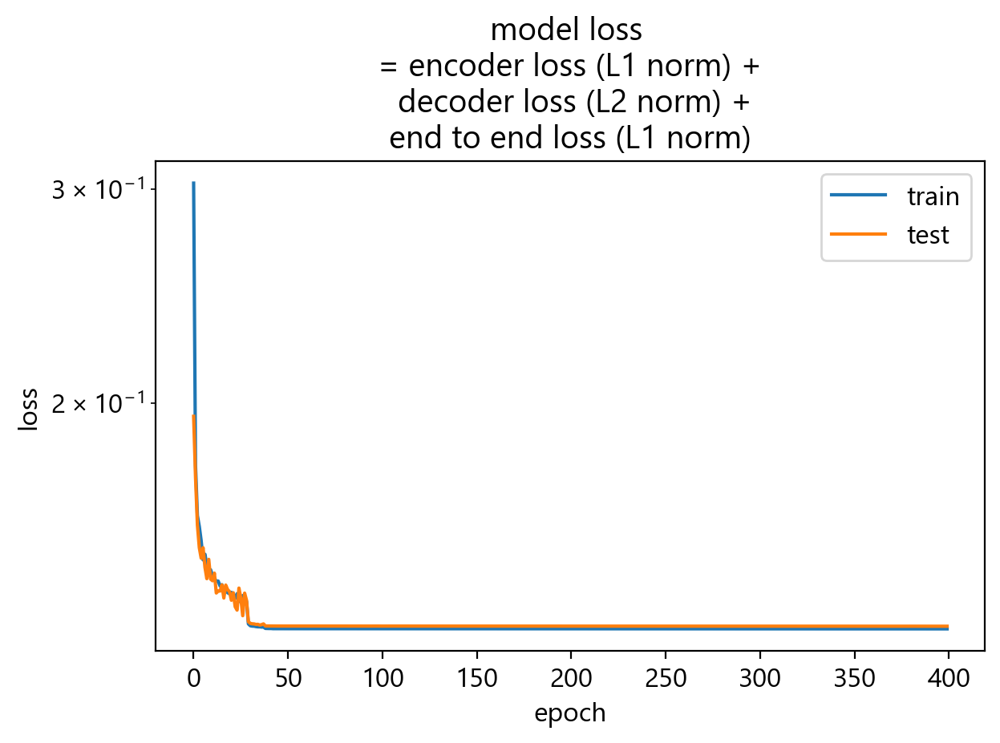

In [52]:
plt.rcParams['text.usetex'] = False
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['font.family'] = 'Segoe UI'
plt.plot(autoencoder.history.history['loss'])
plt.plot(autoencoder.history.history['val_loss'])
plt.title('model loss \n = encoder loss (L1 norm) + \n decoder loss (L2 norm) +\n end to end loss (L1 norm) ')
plt.ylabel('loss')
plt.yscale('log')
plt.xlabel('epoch')
plt.yticks
# plt.xlim(-1,50)
plt.tight_layout()
plt.legend(['train', 'test'], loc='upper right')
plt.show()



m98.png
4096 4096
(4096, 4096, 3)


c:\Users\joeli\anaconda3\envs\tf-gpu_20230406\lib\site-packages\tensorflow\python\keras\engine\training.py:2464: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  warnings.warn('`Model.state_updates` will be removed in a future version. '


encode time: 0.3053719997406006
decode time: 0.34426116943359375
(4096, 4096, 3)


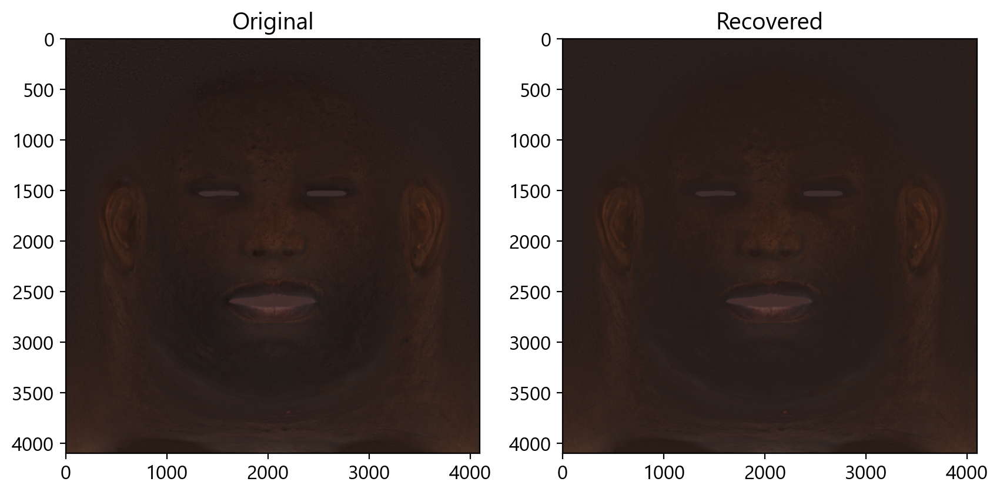

34.060669342676796 0.13615547


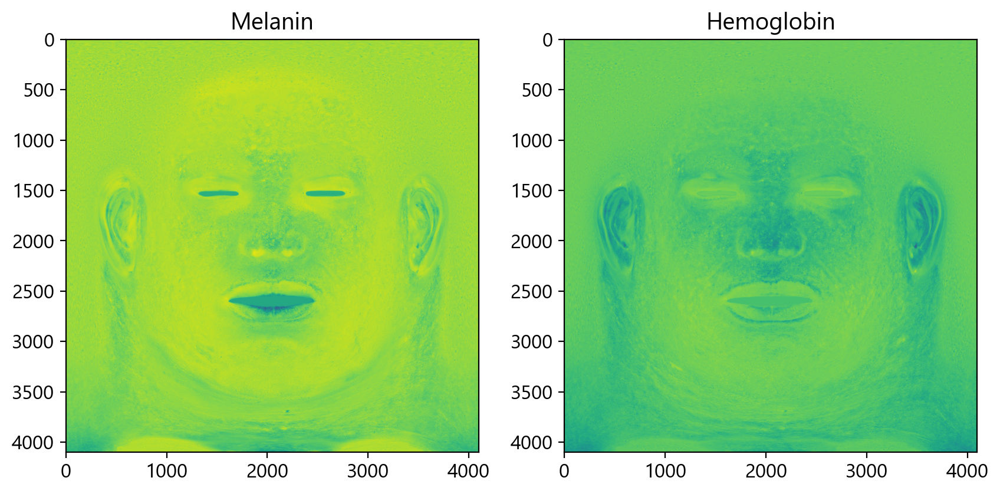

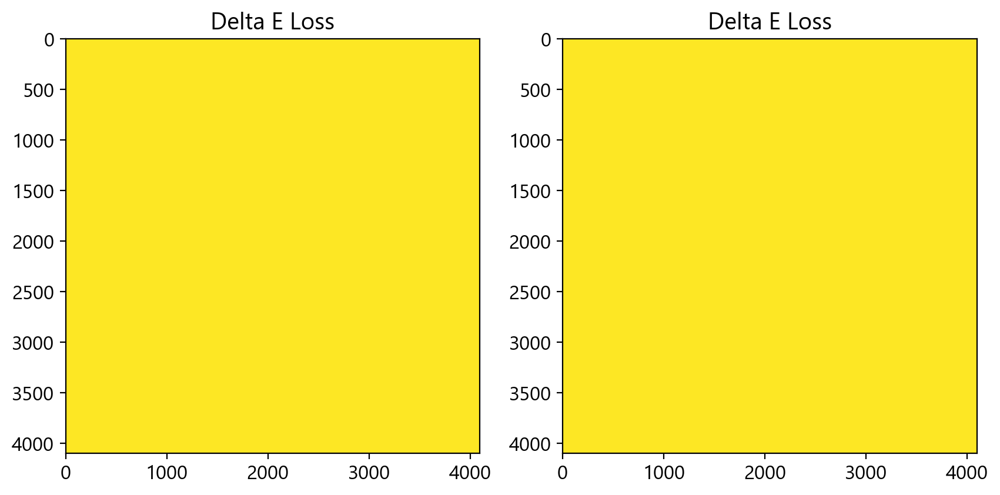

Delta E Loss: 
 mean: 226.05 min: 14.568734000700363 max: 233.9243977752503 std: 9.43


In [53]:
import numpy as np
import os
import time
import matplotlib.pyplot as plt
import matplotlib as mpl
from PIL import Image

CMAP_SPECULAR = plt.get_cmap('viridis')

def encode(img):
    image = np.asarray(img).reshape(-1,3).astype('float32')/255.0
    pred_maps = encoder.predict_on_batch(image)
    return pred_maps

def decode(encoded):
    recovered = decoder.predict_on_batch(encoded)
    recovered = np.clip(recovered, 0, 1)
    return recovered

def process_single_albedo_image(image_path):
    if not os.path.exists(image_path):
        print(f"Path {image_path} does not exist.")
        return

    top_path = "LargeLUT_2k"
    if not os.path.exists(top_path):
        os.mkdir(top_path)
        print(f"created {top_path}")

    albedo_path = os.path.dirname(image_path)
    recovered_path = os.path.join(albedo_path, "recovered")
    original_path = os.path.join(albedo_path, "original")
    parameter_path = os.path.join(albedo_path, "parameters")
    result_path = os.path.join(albedo_path, "results")
    top_path = os.path.join(albedo_path, top_path)

    for path in [recovered_path, original_path, parameter_path, result_path]:
        if not os.path.exists(path):
            os.mkdir(path)
            print(f"created {path}")

    mpl.rcParams['axes.grid'] = False

    file_name = os.path.basename(image_path)
    file_name = file_name.split("_")[1]
    print(file_name)
    Image.MAX_IMAGE_PIXELS = None
    image = Image.open(image_path)
    image = image.resize((4096,4096))
    image = image.convert('RGB')
    height, width = image.size
    print(width, height)

    image = np.asarray(image)
    print(image.shape)
    dim = (width, height)
    encode_start = time.time()
    pred_maps = encode(image)
    #melanin
    melanin = pred_maps[:,0].reshape((width, height))
    # #increase melanin 
    # melanin = melanin * 1.1+0.1
    # pred_maps[:,0] = melanin.reshape((width*height))
    # #hemoglobin
    hemoglobin = pred_maps[:,1].reshape((width, height))
    # #Bm
    # blend_mel = pred_maps[:,2].reshape((width, height))
    # blend_mel = blend_mel * 1.2+0.1
    encode_end = time.time()
    encode_time = encode_end - encode_start
    print(f"encode time: {encode_time}")
    decode_start = time.time()
    recovered = decode(pred_maps)
    decode_end = time.time()
    decode_time = decode_end - decode_start
    print(f"decode time: {decode_time}")
    recovered = np.reshape(recovered, (width, height, 3))
    print(recovered.shape)
    #



    return image, pred_maps, recovered, melanin, hemoglobin
    # ... (The rest of the code remains unchanged) ...

if __name__ == "__main__":
    image_path = r"C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\AlbedoTextures\text_xyz\albedo_m98.png"
    image, pred_maps, recovered,melanin, hemoglobin = process_single_albedo_image(image_path)
    #plot original and recovered side by side set fig size bigger than default
    plt.figure(figsize=(10,10))
    plt.subplot(1,2,1)
    plt.imshow(image)
    plt.title("Original")
    plt.subplot(1,2,2)
    plt.title("Recovered")
    plt.imshow(recovered)
    plt.show()
    #plot the maps
    plt.figure(figsize=(10,10))
    plt.subplot(2,2,1)
    plt.imshow(melanin, cmap='viridis')
    plt.title("Melanin")
    plt.subplot(2,2,2)
    plt.imshow(hemoglobin, cmap='viridis')
    plt.title("Hemoglobin")
    #save recovered image
    plt.imsave(r"C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\Results\txyz01\Original_Albedos_2048by2048\Increased_Melanin_Bm_recovered_m32.png", recovered, dpi=2000)
    #calculate delta E
    import colorspacious
    image_mean = np.mean(image)
    recovered_mean = np.mean(recovered)
    print(image_mean, recovered_mean)
    original_lab = colorspacious.cspace_convert(np.array(image), 'sRGB1', 'CAM02-UCS')
    recovered_lab = colorspacious.cspace_convert(np.array(recovered), 'sRGB1', 'CAM02-UCS')
    delta_e = np.sqrt(np.sum((original_lab - recovered_lab)**2, axis=-1))
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    delta_e_plot = axs[0].imshow(delta_e, cmap='viridis', vmin=0, vmax=20, aspect='equal')
    delta_e_plot = axs[1].imshow(delta_e, cmap='viridis', vmin=0, vmax=20, aspect='equal')
    axs[0].set_title(f'Delta E Loss')
    axs[1].set_title(f'Delta E Loss')
    #show 
    plt.show()
    #make colorbar vertical and to the right of the delta e loss plot
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(delta_e_plot, cax=cbar_ax, shrink=0.1, aspect=.2, ticks=[0, 5, 10, 15, 20])
    #set height and width of colorbar
    cbar.ax.width = 0.1   
    cbar.ax.height = 0.2
    cbar.ax.tick_params(labelsize=8)
    
    print(f"Delta E Loss: \n mean: {np.mean(delta_e):.2f} min: {np.min(delta_e)} max: {np.max(delta_e)} std: {np.std(delta_e):.2f}")


original_m104.png
2048 2048
(2048, 2048, 3)
shape of pred_maps (4194304, 5)
encode time: 0.06201815605163574
decode time: 0.07505011558532715
(2048, 2048, 3)


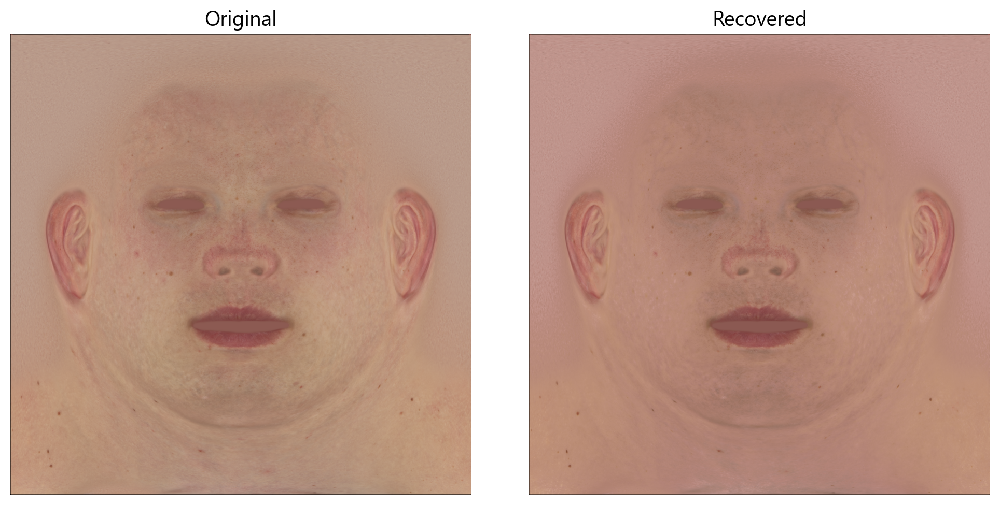

file original_m104.png


KeyboardInterrupt: 

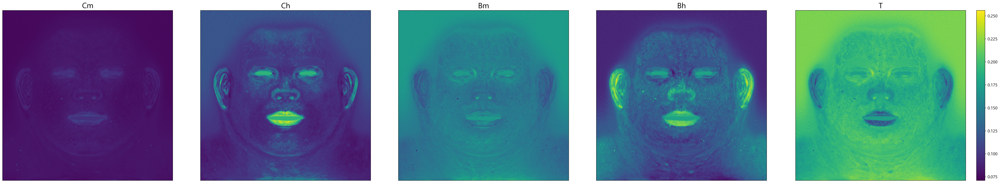

In [43]:
def encode(img):
    image = np.asarray(img).reshape(-1,3).astype('float32')/255.0
    # pred_maps = encoder.predict(image)
    pred_maps = encoder.predict_on_batch(image)
    print(f"shape of pred_maps {pred_maps.shape}")
    return pred_maps
 
def decode(encoded):
    # recovered = decoder.predict(encoded)
    recovered = decoder.predict_on_batch(encoded)
    #clamp to 0-1
    recovered = np.clip(recovered, 0, 1)
    return recovered


test_path = r"C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\AlbedoTextures\text_xyz\original\original"
# C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\Results\txyz01\Original_Albedos_2048by2048
top_path = "LargeLUT_2k"
if not os.path.exists(top_path):
    os.mkdir(top_path)
    print(f"created {top_path}")
recovered_path = os.path.join(test_path, "recovered")
original_path = os.path.join(test_path, "original")
parameter_path = os.path.join(test_path, "parameters")
result_path = os.path.join(test_path, "results")
result_path = r"C:\Users\joeli\OneDrive\Desktop\results\dump_output"
top_path = os.path.join(test_path, top_path)
if not os.path.exists(recovered_path):
    os.mkdir(recovered_path)
    print(f"created {recovered_path}")
if not os.path.exists(original_path):
    os.mkdir(original_path)
    print(f"created {original_path}")
if not os.path.exists(parameter_path):
    os.mkdir(parameter_path)
    print(f"created {parameter_path}")
if not os.path.exists(result_path):
    os.mkdir(result_path)
    print(f"created {result_path}")
test_images = os.listdir(test_path)
length = len(test_images)
#for each image in the test set
for i in range(len(test_images)):
    if not test_images[i].endswith(".png"):
        continue
    length -= 1
    if length <= 2:
        break
    mpl.rcParams['axes.grid'] = False

    image_path = os.path.join(test_path, test_images[i])
    file_name = os.path.basename(image_path)
    print(file_name)
    Image.MAX_IMAGE_PIXELS = None
    image = Image.open(image_path)
    image = image.resize((2048,2048))
    image = image.convert('RGB')
    height, width = image.size
    print(width, height)
    image = np.asarray(image)
    print(image.shape)
    dim = (width, height)
    encode_start = time.time()
    pred_maps = encode(image)


    encode_end = time.time()
    encode_time = encode_end - encode_start
    print(f"encode time: {encode_time}")
    decode_start = time.time()
    recovered = decode(pred_maps)
    decode_end = time.time()
    decode_time = decode_end - decode_start
    print(f"decode time: {decode_time}")
    recovered = np.reshape(recovered, (width, height, 3))
    print(recovered.shape)

    #plot original and recovered side by side set fig size bigger than default
    plt.figure(figsize=(10,5))
    plt.subplot(1,2,1)
    plt.imshow(image)
    plt.title("Original")
    plt.subplot(1,2,2)
    plt.title("Recovered")
    plt.imshow(recovered)
    plt.tight_layout(h_pad=0, w_pad=0, pad=0)
    for ax in plt.gcf().axes:
        ax.axis('off')
    plt.show()
    # pred_maps = np.reshape(pred_maps, (width,height, 5))

    c_m = np.asarray(pred_maps[:,0]).reshape(width, height)
    #increase melanin amount
    c_m = c_m * 10+0.2
    c_h = np.asarray(pred_maps[:,1]).reshape(width, height)
    b_m = np.asarray(pred_maps[:,2]).reshape(width, height)
    b_h = np.asarray(pred_maps[:,3]).reshape(width, height)
    t = np.asarray(pred_maps[:,4]).reshape(width, height)

    #save images
    print(f"file {file_name}")
    dir_file = f"{file_name}"
    path = os.path.join(original_path, dir_file)
    # plt.imsave(path, image, dpi=1000)
    dir_file = f"Cm_{file_name}"
    path = os.path.join(parameter_path, dir_file)
    plt.imsave(path, c_m, cmap=CMAP_SPECULAR, dpi=1000)
    dir_file = f"Ch_{file_name}"
    path = os.path.join(parameter_path, dir_file)
    plt.imsave(path, c_h, cmap=CMAP_SPECULAR, dpi=1000)
    dir_file = f"Bm_{file_name}"
    path = os.path.join(parameter_path, dir_file)
    plt.imsave(path, b_m, cmap=CMAP_SPECULAR, dpi=1000)
    dir_file = f"Bh_{file_name}"
    path = os.path.join(parameter_path, dir_file)
    plt.imsave(path, b_h, cmap=CMAP_SPECULAR, dpi=1000)
    dir_file = f"T_{file_name}"
    path = os.path.join(parameter_path, dir_file)
    plt.imsave(path, t, cmap=CMAP_SPECULAR, dpi=1000)
    dir_file = f"recovered_{file_name}"
    path = os.path.join(recovered_path, dir_file)
    recovered = recovered.reshape(width, height, 3)
    plt.imsave(path, recovered, dpi=1000)
    dir_file = f"original_{file_name}"
    path = os.path.join(original_path, dir_file)
    plt.imsave(path, image, dpi=1000)


    #plot image, Cm,Ch,Bm,t, reconstructed image
    fig, axs = plt.subplots(1, 5, figsize=(40, 7) )
    #set wspace and hspace to 0
    fig.subplots_adjust(wspace=0, hspace=0)
    #remove ticks and labels

    axs[0].imshow(c_m, cmap=CMAP_SPECULAR)
    # plt.colorbar(axs[1].imshow(c_m, cmap=CMAP_SPECULAR), ax=axs[1],fraction=0.046, pad=0.04)
    axs[0].set_title('Cm', fontsize=22)
    axs[1].imshow(c_h, cmap=CMAP_SPECULAR)
    # plt.colorbar(axs[2].imshow(c_h, cmap=CMAP_SPECULAR), ax=axs[2],fraction=0.046, pad=0.04)
    axs[1].set_title('Ch', fontsize=22)
    axs[2].imshow(b_m, cmap=CMAP_SPECULAR)
    # plt.colorbar(axs[3].imshow(b_m, cmap=CMAP_SPECULAR), ax=axs[3],fraction=0.046, pad=0.04)
    axs[2].set_title('Bm', fontsize=22)
    axs[3].imshow(b_h, cmap=CMAP_SPECULAR)
    # plt.colorbar(axs[4].imshow(b_h, cmap=CMAP_SPECULAR), ax=axs[4],fraction=0.046, pad=0.04)
    axs[3].set_title('Bh', fontsize=22)
    axs[4].imshow(t, cmap=CMAP_SPECULAR)
    plt.colorbar(axs[4].imshow(t, cmap=CMAP_SPECULAR), ax=axs[4],fraction=0.046)
    axs[4].set_title('T', fontsize=22)
    for ax in axs:
        ax.set_xticks([])
        ax.set_yticks([])
    # plt.suptitle('Original Image, Biophysical Parameter Maps, recovered Image \n  Encode Time: {}s, Decode Time: {}s'.format(encode_time, decode_time),y=.85, fontsize=20)
    #tight layout
    plt.tight_layout(pad=0, w_pad=0, h_pad=0)
    #save figure
    dir_file = f"parameter_maps_{file_name}"
    path = os.path.join(result_path, dir_file)
    plt.savefig(path, dpi=1000)

    plt.show()


(2048, 2048)
(2048, 2048)
Delta E Loss: 
 mean: 1.18 min: 0.0 max: 246.84520573376503 std: 10.86


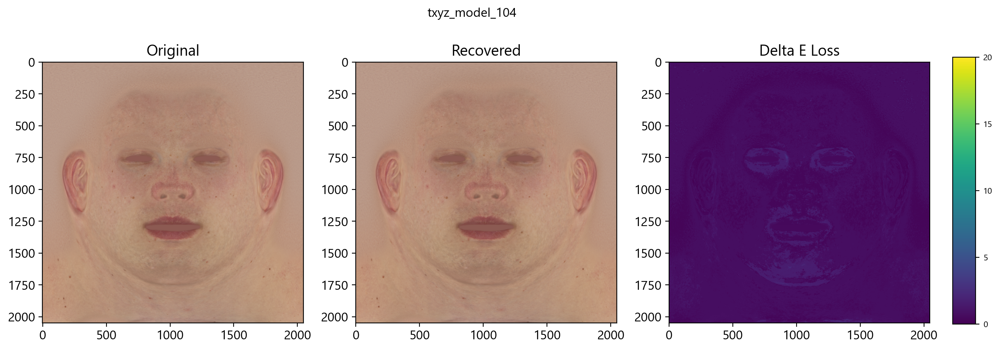

(2048, 2048)
(2048, 2048)
Delta E Loss: 
 mean: 1.74 min: 0.0 max: 246.84520573376503 std: 10.87


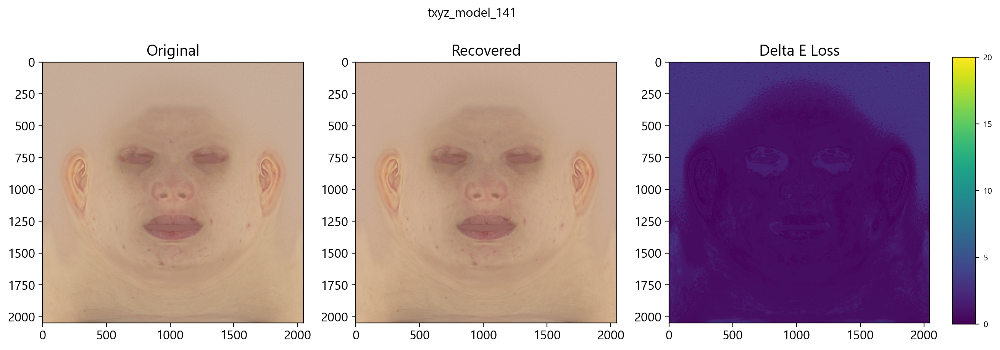

(2048, 2048)
(2048, 2048)
Delta E Loss: 
 mean: 1.20 min: 0.0 max: 246.84520573376503 std: 10.86


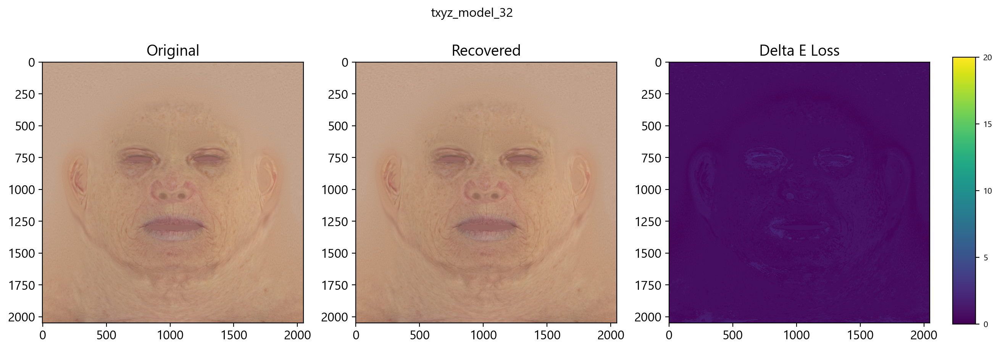

(2048, 2048)
(2048, 2048)
Delta E Loss: 
 mean: 1.63 min: 0.0 max: 246.84520573376503 std: 10.84


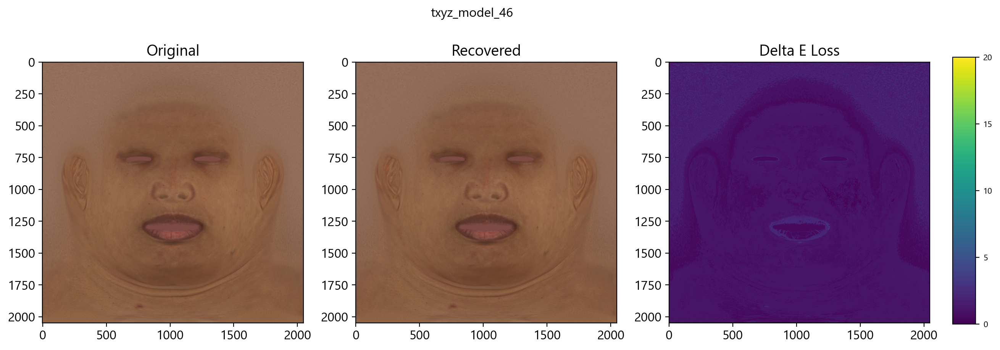

(2048, 2048)
(2048, 2048)
Delta E Loss: 
 mean: 1.07 min: 0.0 max: 246.84520573376503 std: 10.86


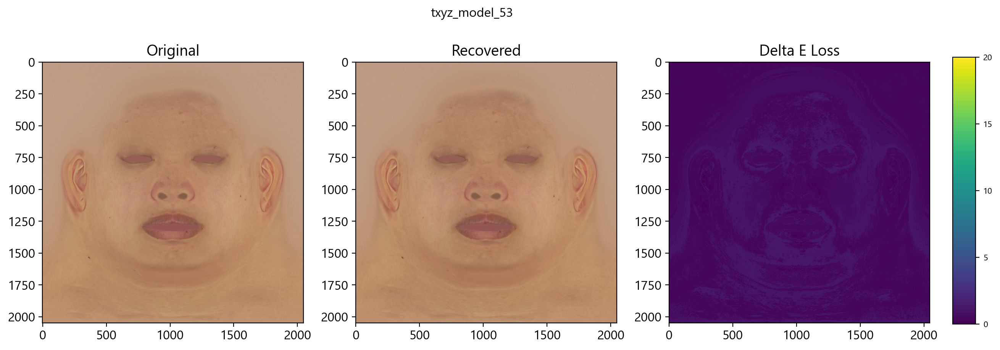

(2048, 2048)
(2048, 2048)
Delta E Loss: 
 mean: 1.21 min: 0.0 max: 246.84520573376503 std: 10.21


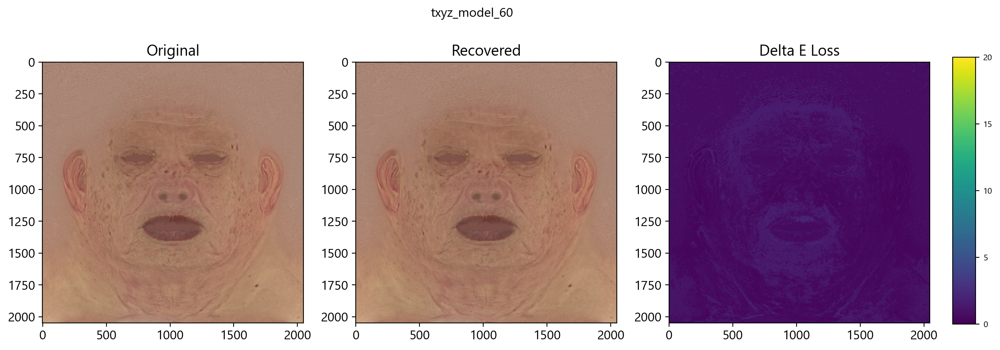

(2048, 2048)
(2048, 2048)
Delta E Loss: 
 mean: 1.26 min: 0.0 max: 246.84520573376503 std: 10.72


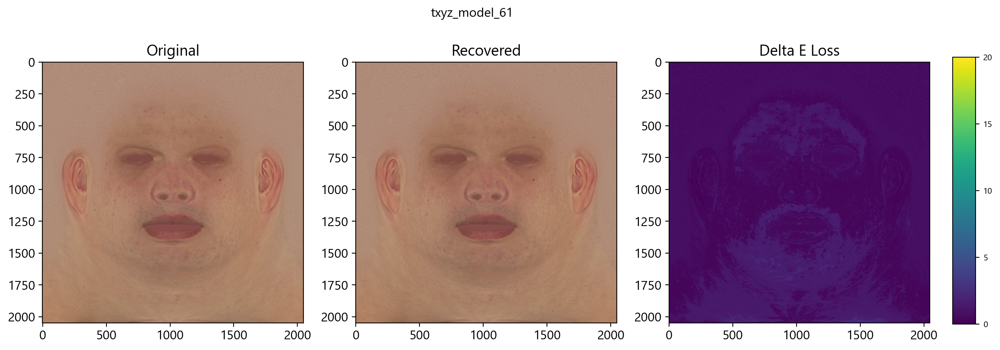

(2048, 2048)
(2048, 2048)
Delta E Loss: 
 mean: 1.90 min: 0.0 max: 246.84520573376503 std: 7.24


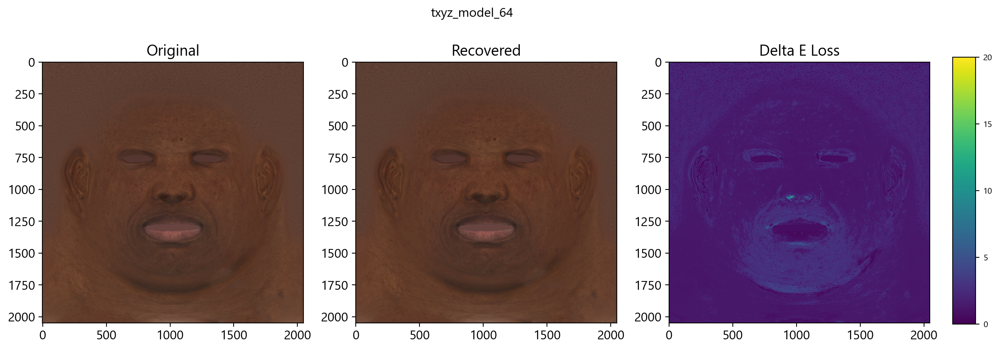

(2048, 2048)
(2048, 2048)
Delta E Loss: 
 mean: 1.42 min: 0.0 max: 246.84520573376503 std: 9.20


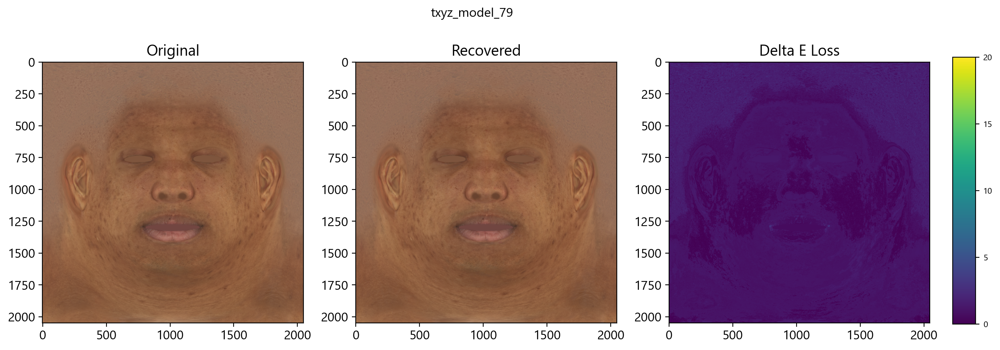

(2048, 2048)
(2048, 2048)
Delta E Loss: 
 mean: 6.68 min: 0.0 max: 246.84520573376503 std: 11.13


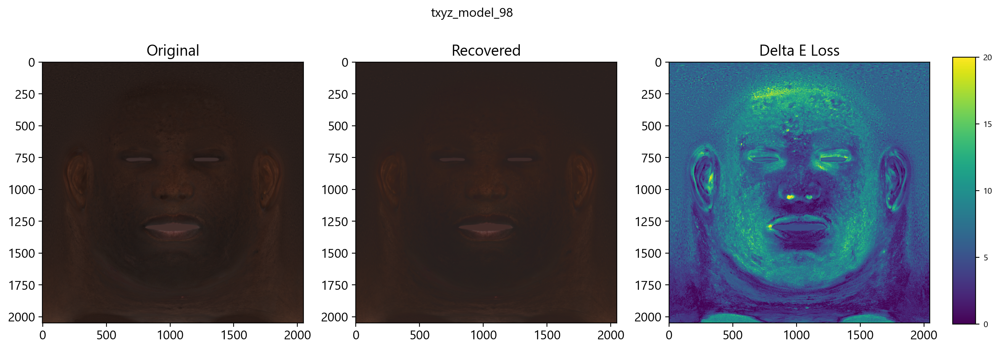

In [42]:
import os
import numpy as np
from PIL import Image
import colorspacious
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['axes.grid'] = False
plt.rcParams['figure.dpi'] = 200
# Set the directories for the original and recovered images
original_directory = r'C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\Results\txyz01\Original_Albedos_2048by2048'
recovered_directory = r'C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\Results\txyz01\Recovered_Albedos_2048by2048'

# Get a list of file names in the original and recovered image directories
original_files = os.listdir(original_directory)
recovered_files = os.listdir(recovered_directory)


# Loop over the original files and match them to the recovered files
#get 1st file
# original_file = original_files[0]
# recovered_file = recovered_files[0]

for i, (original_file, recovered_file) in enumerate(zip(original_files, recovered_files)):
    original_img = Image.open(os.path.join(original_directory, original_file)).convert('RGB')
    recovered_img = Image.open(os.path.join(recovered_directory, recovered_file)).convert('RGB')
    print(original_img.size)
    print(recovered_img.size)
    widths = [1, 1, 1]
    heights = [1]
    # Create a 1x3 subplot for each pair of original and recovered images
    fig, axs = plt.subplots(1, 3, figsize=(15,5))

    # Plot the original image in the first subplot
    axs[0].imshow(original_img)
    axs[0].set_title('Original')
    
    # Plot the recovered image in the second subplot
    axs[1].imshow(recovered_img)
    axs[1].set_title('Recovered')
    
    # Plot the delta E loss in the third subplot
    # Convert the images to the CAM02-UCS color space and calculate the delta E loss
    original_lab = colorspacious.cspace_convert(np.array(original_img), 'sRGB1', 'CAM02-UCS')
    recovered_lab = colorspacious.cspace_convert(np.array(recovered_img), 'sRGB1', 'CAM02-UCS')
    delta_e = np.sqrt(np.sum((original_lab - recovered_lab)**2, axis=2))
    delta_e_plot = axs[2].imshow(delta_e, cmap='viridis', vmin=0, vmax=20, aspect='equal')
    delta_e_plot = axs[2].imshow(delta_e, cmap='viridis', vmin=0, vmax=20, aspect='equal')
    axs[2].set_title(f'Delta E Loss')
    #make colorbar vertical and to the right of the delta e loss plot
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(delta_e_plot, cax=cbar_ax, shrink=0.1, aspect=.2, ticks=[0, 5, 10, 15, 20])
    #set height and width of colorbar
    cbar.ax.width = 0.1   
    cbar.ax.height = 0.2
    cbar.ax.tick_params(labelsize=8)
    
    print(f"Delta E Loss: \n mean: {np.mean(delta_e):.2f} min: {np.min(delta_e)} max: {np.max(delta_e)} std: {np.std(delta_e):.2f}")

    # # Add a colorbar to the figure
    # cbar_ax = axs[3]
    # cbar = fig.colorbar(delta_e_plot, cax=cbar_ax, shrink=0.1, aspect=.2, ticks=[0, 5, 10, 15, 20])
    # #set height and width of colorbar
    # cbar.ax.width = 0.1
    # cbar.ax.height = 0.2
    # cbar.ax.tick_params(labelsize=8)

    # Set the title of the figure
    title = original_file.split('_')[1]
    title = ''.join(filter(lambda x: x.isdigit(), title))
    title = f"txyz_model_{title}"
    fig.suptitle(f'{title}', fontsize=12)
    #no whitespace around figure
    plt.margins(0,0)
    # Save the figure
    dir_file = f"delta_e_loss_{title}.png"
    fig.savefig(dir_file, dpi = 1500)
    # plt.tight_layout(pad=0, w_pad=0, h_pad=0)
    plt.show()


In [ ]:
# import os

# # input_name = input("enter name of model to save:")
# input_name = "March25"

# #save model
# save_path = r"C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\TrainedModels"
# encoder_path = os.path.join(save_path, f"{input_name}_encoder")
# decoder_path = os.path.join(save_path, f"{input_name}_decoder")
# autoencoder_path = os.path.join(save_path, f"{input_name}_autoencoder")
# print(encoder_path)
# print(decoder_path)
# print(autoencoder_path)
# #save model weights and architecture to single file as h5
# encoder.save(encoder_path, save_format="h5py")
# decoder.save(decoder_path, save_format="h5py")

In [ ]:
# saved_encoder_h5 = r"C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\TrainedModels\March25_encoder"
# saved_decoder_h5 = r"C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\TrainedModels\March25_decoder"
# reload_encoder = tf.keras.models.load_model(saved_encoder_h5)
# reload_decoder = tf.keras.models.load_model(saved_decoder_h5)



In [ ]:
# # input_name = input("enter name of model to save:")
# input_name = "March25"

# #save model
# save_path = r"C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\json_models"
# encoder_path = os.path.join(save_path, f"{input_name}_encoder")
# decoder_path = os.path.join(save_path, f"{input_name}_decoder")
# autoencoder_path = os.path.join(save_path, f"{input_name}_autoencoder")
# #save as json
# encoder_path 
# encoder_json = encoder.to_json()
# decoder_json = decoder.to_json()
# with open(f"{encoder_path}.json", "w") as json_file:
#     json_file.write(encoder_json)
# with open(f"{decoder_path}.json", "w") as json_file:
#     json_file.write(decoder_json)


In [ ]:
# #save model weights and architecture to single file as h5
# encoder.save_weights(encoder_path)
# decoder.save_weights(decoder_path)

In [ ]:
# import os
# import tensorflow as tf
# from tensorflow.python.framework import graph_io
# # from tensorflow.python.compiler.tensorrt import trt_convert as trt

# def export_model(model, input_node_names, output_node_name, model_name):
#     if not os.path.exists('out'):
#         os.mkdir('out')

#     # Save the model in the TensorFlow SavedModel format
#     model.save(r'C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\json_models\{model_name}', save_format='h5py')

#     # Convert the Keras model to a frozen graph
#     frozen_graph = tf.compat.v1.graph_util.convert_variables_to_constants(
#         sess=tf.compat.v1.keras.backend.get_session(),
#         input_graph_def=tf.compat.v1.keras.backend.get_session().graph.as_graph_def(),
#         output_node_names=[output_node_name]
#     )

#     # Save the frozen graph to a binary protobuf file
#     graph_io.write_graph(frozen_graph, 'out', f'frozen_{model_name}.pb', as_text=False)

#     # Optimize the frozen graph for inference
#     input_graph_def = frozen_graph
#     output_graph_def = tf.compat.v1.graph_util.remove_training_nodes(input_graph_def)

#     # Save the optimized graph to a binary protobuf file
#     with tf.io.gfile.GFile(f'out/opt_{model_name}.pb', 'wb') as f:
#         f.write(output_graph_def.SerializeToString())

#     print("Graph saved!")

# # Example usage:
# encoder_model = encoder
# input_node_names = [encoder_model.input.name.split(':')[0]]
# output_node_name = encoder_model.output.name.split(':')[0]
# export_model(encoder_model, input_node_names, output_node_name, "encoder")



In [ ]:

# import onnxruntime as onnx
# import json
# # import frozen_graph
# from tensorflow.python.framework import graph_io
# """


# encoder.save(encoder_path, save_format="h5py")
# decoder.save(decoder_path, save_format="h5py") """ 

# """save model based on chosen prefix"""
# def save_model(model,path, name, file_prefix):
#     if file_prefix.endswith("onnx"):
#         model.save(os.path.join(path, name, file_prefix))
#         # Save the frozen graph to a binary protobuf file
#         frozen_graph = tf.compat.v1.graph_util.convert_variables_to_constants(model)
#         graph_io.write_graph(frozen_graph, 'out', f'frozen_{model}.pb', as_text=False)
#     elif file_prefix.endswith("h5"):
#         model.save(os.path.join(path, name, file_prefix), save_format="h5py")
#     elif file_prefix.endswith("json"):
#         model_json = model.to_json()
#         with open(os.path.join(path, name, file_prefix), "w") as json_file:
#             json_file.write(model_json)

In [ ]:
# path = r"C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\encoder_march26"
# save_model(encoder, path, "encoder", ".onnx")
# save_model(encoder_model, path, "encoder", ".h5")
# save_model(encoder_model, path, "encoder", ".json")

In [ ]:
# import numpy as np
# import imageio
# from colorspacious import cspace_convert
# from PIL import Image

# # Increase the maximum image size limit
# Image.MAX_IMAGE_PIXELS = None  # Remove the limit, or set a higher value



# def calculate_delta_e_stats(image1_path, image2_path):
#     # Read the images
#     image1 = imageio.imread(image1_path)
#     image2 = imageio.imread(image2_path)

#     # Check if images have the same shape
#     if image1.shape != image2.shape:
#         raise ValueError("The two images must have the same dimensions")

#     # Remove the alpha channel if present
#     if image1.shape[-1] == 4:
#         image1 = image1[:, :, :3]
#     if image2.shape[-1] == 4:
#         image2 = image2[:, :, :3]

#     # Convert images from sRGB to CIELAB color space
#     image1_lab = cspace_convert(image1, "sRGB255", "CIELab")
#     image2_lab = cspace_convert(image2, "sRGB255", "CIELab")

#     # Calculate the squared difference for each color channel
#     delta_squared = (image1_lab - image2_lab) ** 2

#     # Calculate the CIE Delta E loss (euclidean distance in CIELAB space)
#     delta_e_loss = np.sqrt(np.sum(delta_squared, axis=-1))

#     # Calculate the minimum, mean, and maximum Delta E loss for the entire image
#     min_delta_e_loss = np.min(delta_e_loss)
#     mean_delta_e_loss = np.mean(delta_e_loss)
#     max_delta_e_loss = np.max(delta_e_loss)

#     return min_delta_e_loss, mean_delta_e_loss, max_delta_e_loss


# original_path_01 = r"C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\Results\txyz01\original_2048x2048.png"
# recovered_path_01 = r"C:\Users\joeli\OneDrive\Documents\GitHub\AutoEncoder_Integrated\Results\txyz01\recovered_2048x2048.png"

# min_delta_e, mean_delta_e, max_delta_e  = calculate_delta_e_stats(original_path_01, recovered_path_01)
# print("Minimum Delta E Loss:", min_delta_e)
# print("Mean Delta E Loss:", mean_delta_e)
# print("Maximum Delta E Loss:", max_delta_e)
# original_image = imageio.imread(original_path_01)
# reconstructed_image = imageio.imread(recovered_path_01)
# #plot the original and the reconstructed image side by side for comparison
# ax, fig = plt.subplots(1, 2, figsize=(10, 5))
# fig[0].imshow(original_image)
# fig[0].set_title("Original Image")
# fig[1].imshow(reconstructed_image)
# fig[1].set_title("Reconstructed Image")
# plt.suptitle(f"Delta E [ Min: {min_delta_e:.2f}, Mean: {mean_delta_e:.2f}, Max: {max_delta_e:.2f}]")
# plt.show()